In [3]:
import glob
import numpy as np
import math
import cv2
from cv2 import aruco
import os
import json

import matplotlib as mpl
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
import pprint as pp

In [4]:
def getVectorFromDic(idx0,idx1):
    return marker_dict[idx0]["tvec"] - marker_dict[idx1]["tvec"]

def getPositionFromDic(idx0):
    return marker_dict[idx0]["tvec"]

# idx0: origin
def getAngleFromDic(idx1,idx0,idx2):
    return getAngle(getVectorFromDic(idx2,idx0),getVectorFromDic(idx1,idx0))

def getDistanceFromDic(idx0,idx1):
     return np.linalg.norm(getVectorFromDic(idx0,idx1))
    
def getJointVec(arr,joint_num):
    return np.array(arr[joint_num*4:joint_num*4+3])

def normalization(vec):
    return vec/np.linalg.norm(vec)

def getSize(vec):
    return np.linalg.norm(vec)

def dotproduct(v1, v2):
    return sum((a*b) for a, b in zip(v1, v2))

def length(v):
    return math.sqrt(dotproduct(v, v))

def getAngle(v1, v2):
    return math.degrees(math.acos(dotproduct(v1, v2) / (length(v1) * length(v2))))

def vec_norm(vec):
    return vec/np.linalg.norm(vec)

def getUpVectorFromRvecs(idx):
    rtx = cv2.Rodrigues(rvecs[idx])[0]
    return rtx.T[2]

# Get Camera Parameters

In [58]:
parameter_dir=r"C:\Users\ZAIO\dev\python_aruco_marker_visualization\camera_parameters"

#load xml file
camera_parameters = {}
# camera_idxs = ["18284509","18284511","18284512"]
camera_idxs = ["18284509"]

parameter_types = ["CameraMatrix","Intrinsics","Distortion"]


for camera_idx in camera_idxs:
    fileToLoad = os.path.join(parameter_dir,camera_idx+".xml")
    fs = cv2.FileStorage(fileToLoad, cv2.FILE_STORAGE_READ)
    _camera_parameter = {}
    for parameter_type in parameter_types:
        _camera_parameter[parameter_type] = fs.getNode(parameter_type).mat()
        camera_parameters[camera_idx] = _camera_parameter

#3d points to image (2nd image)
extri = [0]*3
intri  = [0]*3
dist = [0]*3

for i in range(len(camera_idxs)):
    rotation_matrix = camera_parameters[camera_idxs[i]][parameter_types[0]][:,0:3]
    rvec,_ = cv2.Rodrigues(rotation_matrix)
    tvec = camera_parameters[camera_idxs[i]][parameter_types[0]][:,3]
    
    extri[i] = camera_parameters[camera_idxs[i]][parameter_types[0]]
    intri[i] = camera_parameters[camera_idxs[i]][parameter_types[1]]
    dist[i] = camera_parameters[camera_idxs[i]][parameter_types[2]]
    
camera_index = 0

mtx = camera_parameters[camera_idxs[camera_index]][parameter_types[1]]
dist = camera_parameters[camera_idxs[camera_index]][parameter_types[2]]
pp.pprint(mtx)
pp.pprint(dist)

array([[1.59106837e+03, 0.00000000e+00, 6.34909755e+02],
       [0.00000000e+00, 1.59838858e+03, 5.01707782e+02],
       [0.00000000e+00, 0.00000000e+00, 1.00000000e+00]])
array([[ 1.36945721e-02],
       [-1.94217874e-01],
       [ 2.42371839e-04],
       [ 6.03200809e-04],
       [-4.39915075e+00],
       [ 3.17459364e-03],
       [-3.13005525e-01],
       [-3.73922900e+00]])


In [59]:
#Using 30 selected images
# json_data = {}
# with open(r"C:\Users\ZAIO\dev\opencv\samples\python\data.json") as json_file:
#     json_data = json.load(json_file)
#     pp.pprint(json_data)
    
# pp.pprint(json_data['camera_matrix'])
# pp.pprint(json_data['dist_coeff'])
    
# mtx = np.array(json_data['camera_matrix'])
# dist = np.array(json_data['dist_coeff'])

In [60]:
aruco_dict = aruco.Dictionary_get(aruco.DICT_4X4_250)
length_of_axis = 0.09
markerLength = 0.18


image_data = r"I:\20200730_mutliplearcuo\000000000000_rendered.png"
frame  = cv2.imread(image_data,cv2.IMREAD_UNCHANGED)
frame = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)

gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
parameters =  aruco.DetectorParameters_create()
corners, ids, rejectedImgPoints = aruco.detectMarkers(gray, aruco_dict, parameters=parameters)


frame_markers = aruco.drawDetectedMarkers(frame.copy(), corners, ids)

rvecs,tvecs, objPts = aruco.estimatePoseSingleMarkers(corners, markerLength , mtx, dist)
imaxis = aruco.drawDetectedMarkers(frame.copy(), corners, ids)


for i in range(len(rvecs)):
    imaxis = aruco.drawAxis(imaxis, mtx, dist, rvecs[i], tvecs[i], length_of_axis)



# Marker data to dictionary
marker_dict = {}

for idx,marker_index in enumerate(ids):
    marker_index = marker_index[0]
    _vecs = {}
    _vecs["rvec"] = rvecs[idx][0]
    _vecs["tvec"] = tvecs[idx][0]
    _vecs["corner"] = corners[idx][0]
    marker_dict[marker_index] = _vecs
print("tvecs and rvecs for each marker\n")
# pp.pprint(marker_dict)



tvecs and rvecs for each marker



In [61]:
from scipy.spatial import distance
p1 = [1, 2, 3]
p2 = [4, 5, 6]
d = distance.euclidean(p1, p2)
print(d)

5.196152422706632


In [62]:
print(distance.euclidean(marker_dict[0]["tvec"],marker_dict[1]["tvec"]))
print(distance.euclidean(marker_dict[1]["tvec"],marker_dict[2]["tvec"]))
print(distance.euclidean(marker_dict[2]["tvec"],marker_dict[3]["tvec"]))
print(distance.euclidean(marker_dict[3]["tvec"],marker_dict[4]["tvec"]))

0.2711067329113772
0.1593690759221671
0.18307808559298833
0.18297988708830462


In [63]:
# def annotateDistanceFromDic(idx0,idx1):

def getCenterOnImageFromDic(idx):
    return np.average(marker_dict[idx]["corner"],axis = 0)

In [64]:
# def annotateDistanceFromDic(idx0,idx1):

def getCenterOnImageFromDic(idx):
    return np.average(marker_dict[idx]["corner"],axis = 0)


In [65]:
imagefiles = glob.glob(r'I:\20200810_CameraTest\few\*.png')

In [74]:
imagefiles = imagefiles[10:]
print(imagefiles)

['I:\\20200810_CameraTest\\few\\000000000035_rendered.png', 'I:\\20200810_CameraTest\\few\\000000000036_rendered.png', 'I:\\20200810_CameraTest\\few\\000000000037_rendered.png', 'I:\\20200810_CameraTest\\few\\000000000038_rendered.png', 'I:\\20200810_CameraTest\\few\\000000000039_rendered.png', 'I:\\20200810_CameraTest\\few\\000000000040_rendered.png', 'I:\\20200810_CameraTest\\few\\000000000041_rendered.png', 'I:\\20200810_CameraTest\\few\\000000000042_rendered.png', 'I:\\20200810_CameraTest\\few\\000000000043_rendered.png', 'I:\\20200810_CameraTest\\few\\000000000044_rendered.png', 'I:\\20200810_CameraTest\\few\\000000000045_rendered.png', 'I:\\20200810_CameraTest\\few\\000000000046_rendered.png', 'I:\\20200810_CameraTest\\few\\000000000047_rendered.png', 'I:\\20200810_CameraTest\\few\\000000000048_rendered.png', 'I:\\20200810_CameraTest\\few\\000000000049_rendered.png', 'I:\\20200810_CameraTest\\few\\000000000050_rendered.png', 'I:\\20200810_CameraTest\\few\\000000000051_rendered.pn

[[[-2.04798822  2.04011305  0.39232691]]

 [[-2.07427533  2.06805094  0.30273216]]

 [[-2.117334    2.13293596  0.13303293]]

 [[-2.21286992  2.2528529   0.07119597]]]
tvecs and rvecs for each marker

[[[-2.05583791  2.03653939  0.40736136]]

 [[-2.09461946  2.0752054   0.32390832]]

 [[-2.13353454  2.13604543  0.19923635]]

 [[-2.21377497  2.24243785  0.09716797]]]
tvecs and rvecs for each marker

[[[-1.99094128  1.92322164  0.27688202]]

 [[-2.00891278  1.93759313  0.2519716 ]]

 [[-2.00492998  1.91663538  0.31041646]]

 [[-1.98335974  1.8911066   0.44744234]]]
tvecs and rvecs for each marker

[[[-1.85009493  2.04465554  0.26176312]]

 [[-1.8717565   2.0750361   0.23541364]]

 [[-1.90959406  2.09866104  0.234824  ]]

 [[-1.95792298  2.14163222  0.40919477]]]
tvecs and rvecs for each marker

[[[-1.90308737  2.02419547  0.25659978]]

 [[-1.92168833  2.06111617  0.25647908]]

 [[-1.97154351  2.10668354  0.2583546 ]]

 [[-2.13402443  2.23291651  0.16367014]]]
tvecs and rvecs for each mar

C:\Users\ZAIO\.conda\envs\cv2\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\ZAIO\.conda\envs\cv2\lib\site-packages\ipykernel_launcher.py:40: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<Figure size 432x288 with 0 Axes>

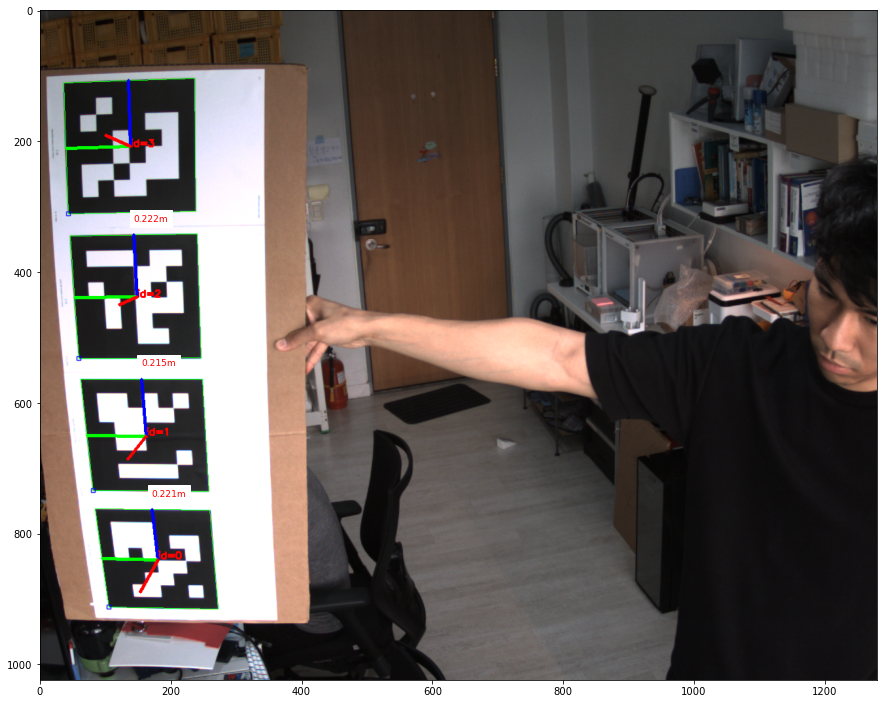

<Figure size 432x288 with 0 Axes>

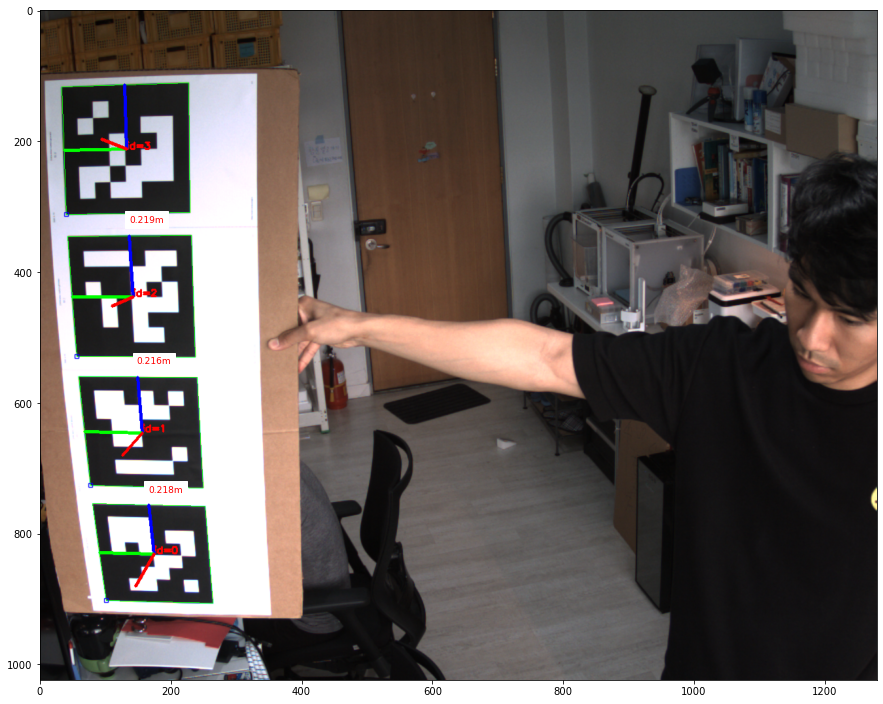

<Figure size 432x288 with 0 Axes>

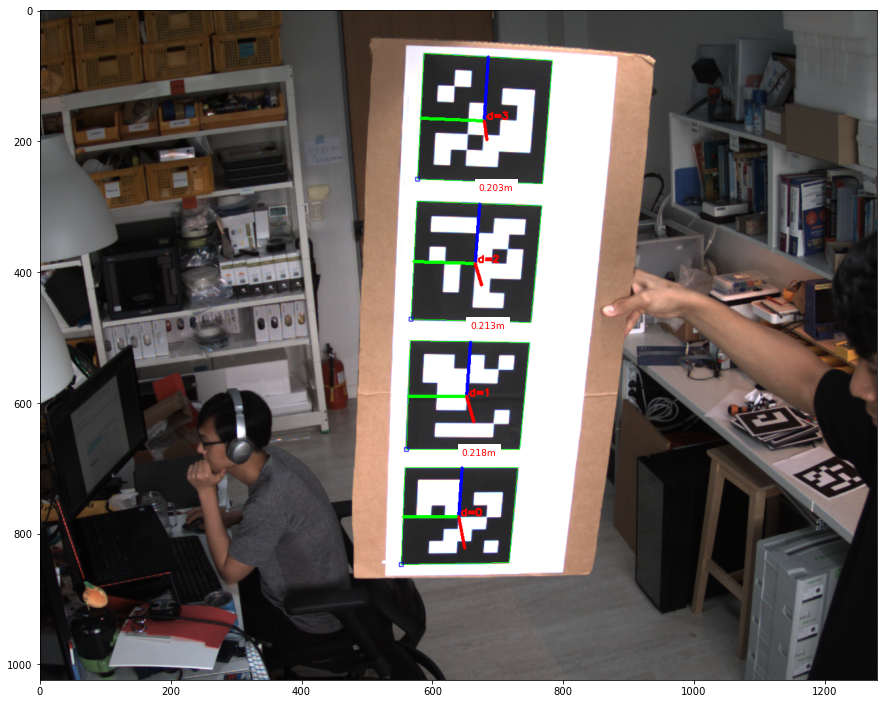

<Figure size 432x288 with 0 Axes>

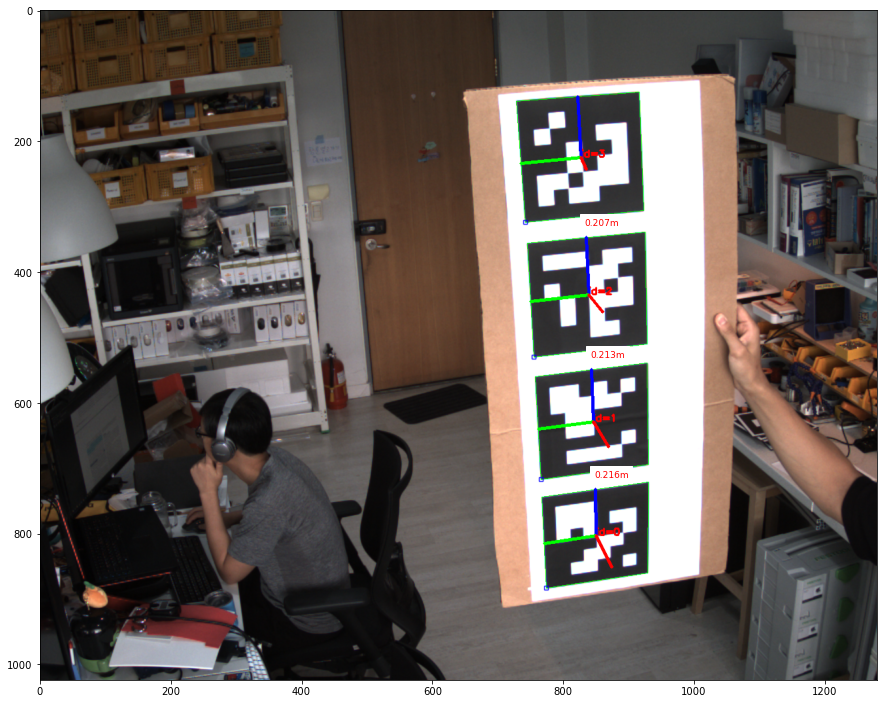

<Figure size 432x288 with 0 Axes>

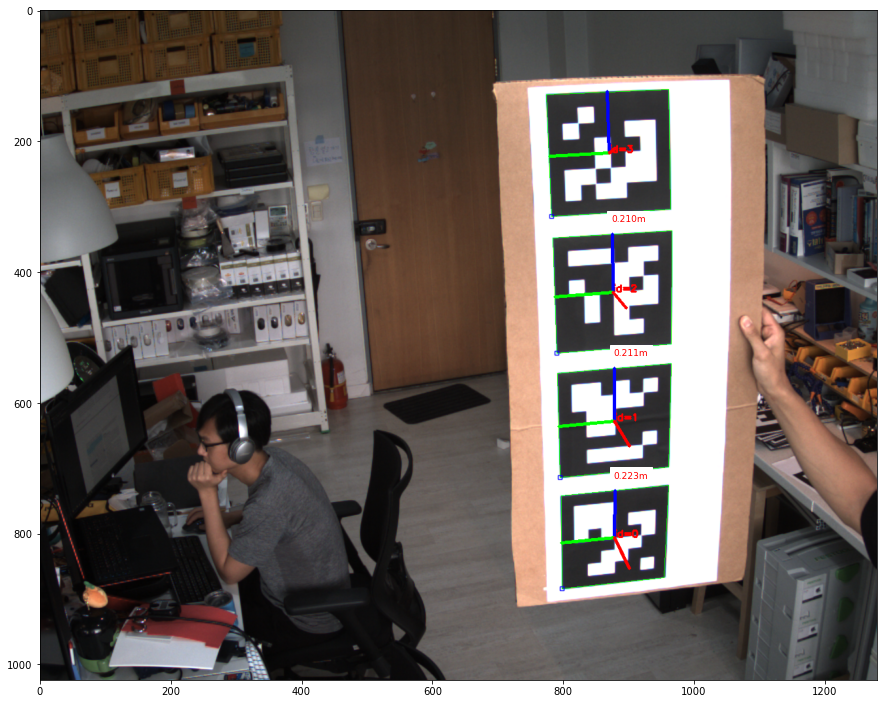

<Figure size 432x288 with 0 Axes>

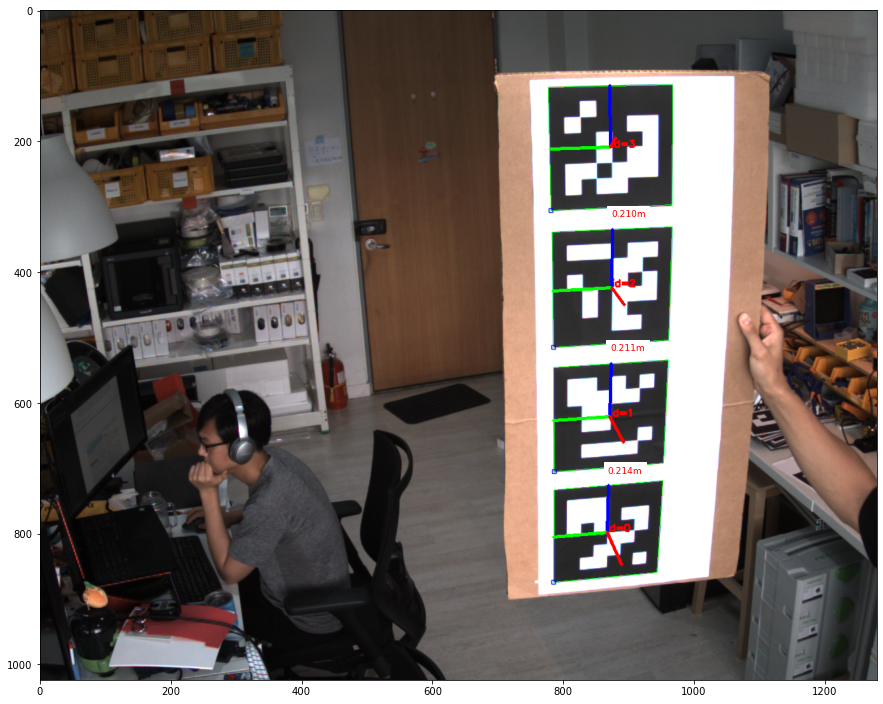

<Figure size 432x288 with 0 Axes>

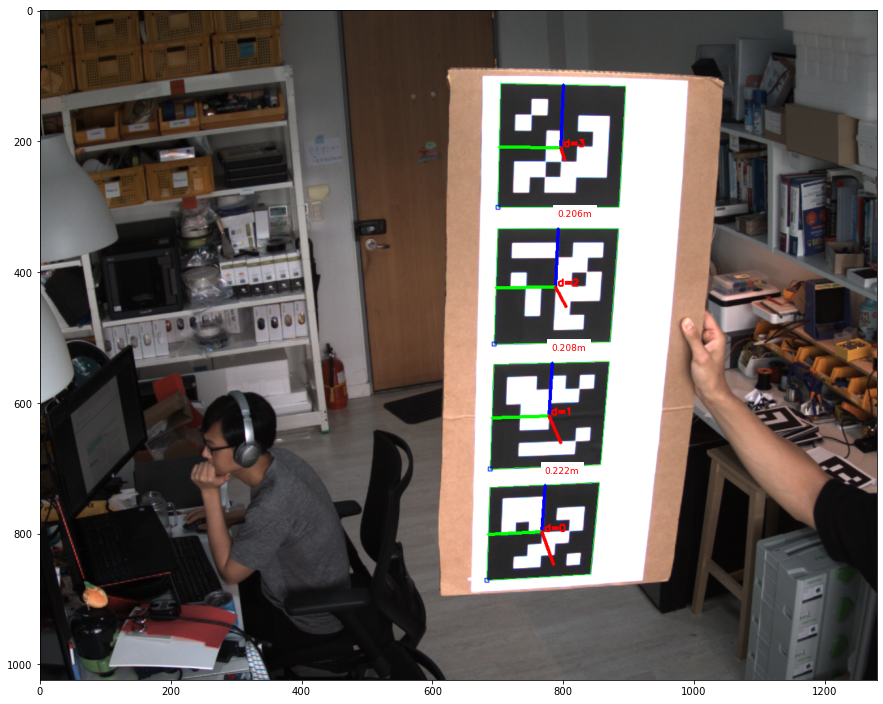

<Figure size 432x288 with 0 Axes>

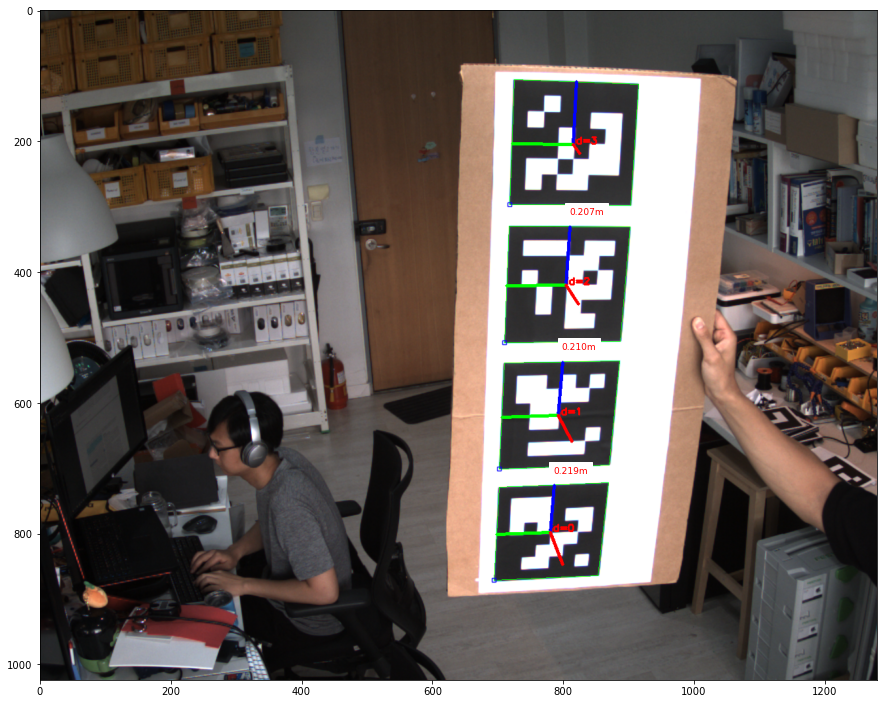

<Figure size 432x288 with 0 Axes>

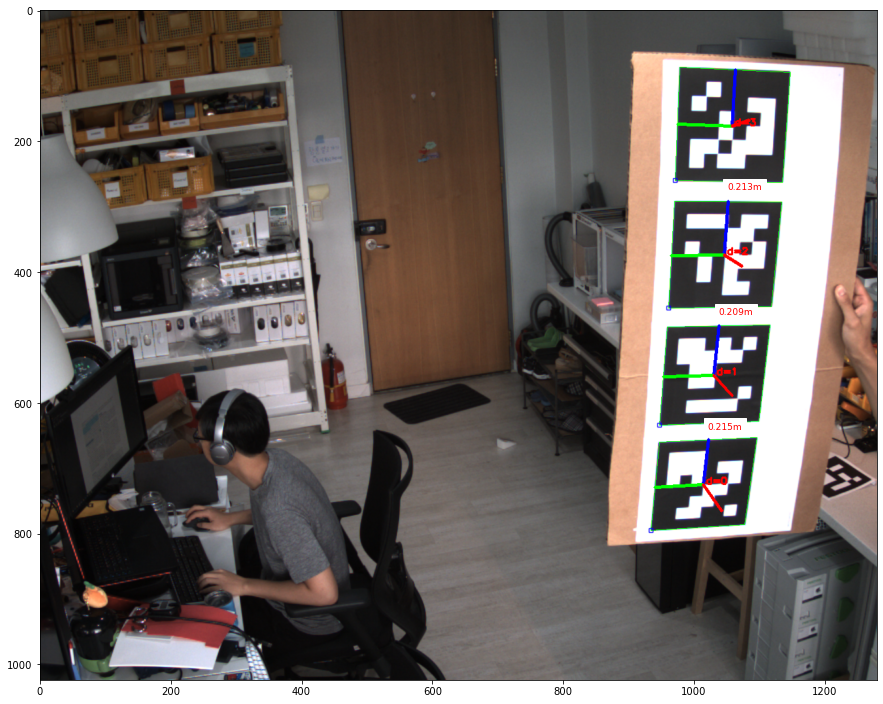

<Figure size 432x288 with 0 Axes>

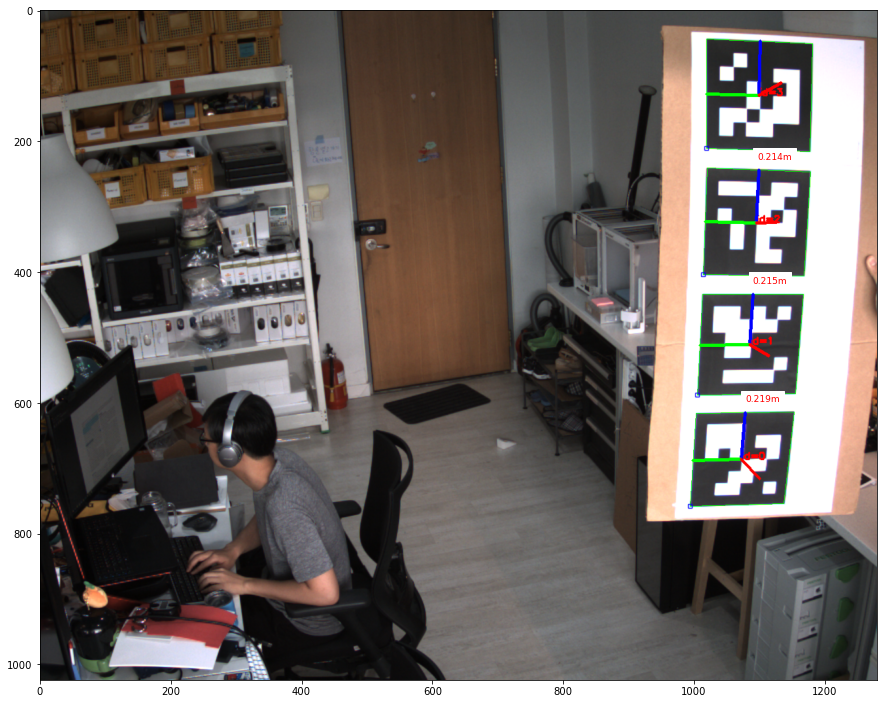

<Figure size 432x288 with 0 Axes>

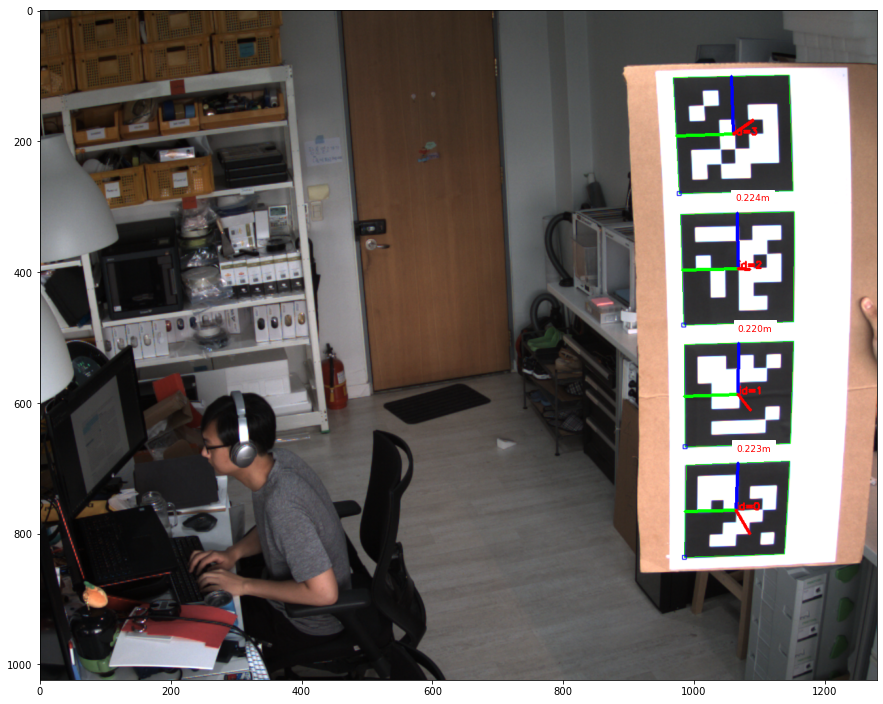

<Figure size 432x288 with 0 Axes>

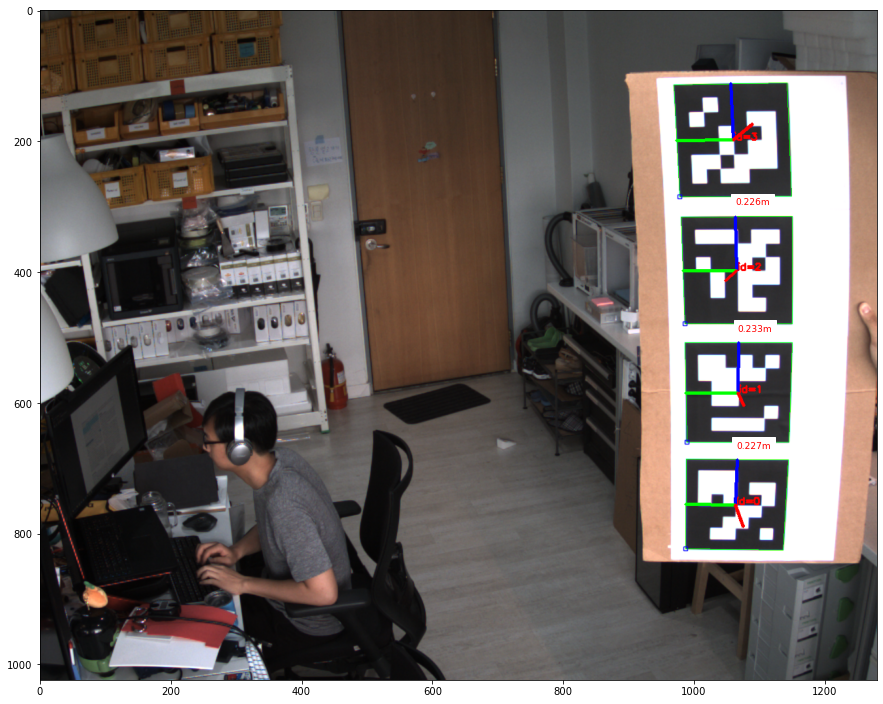

<Figure size 432x288 with 0 Axes>

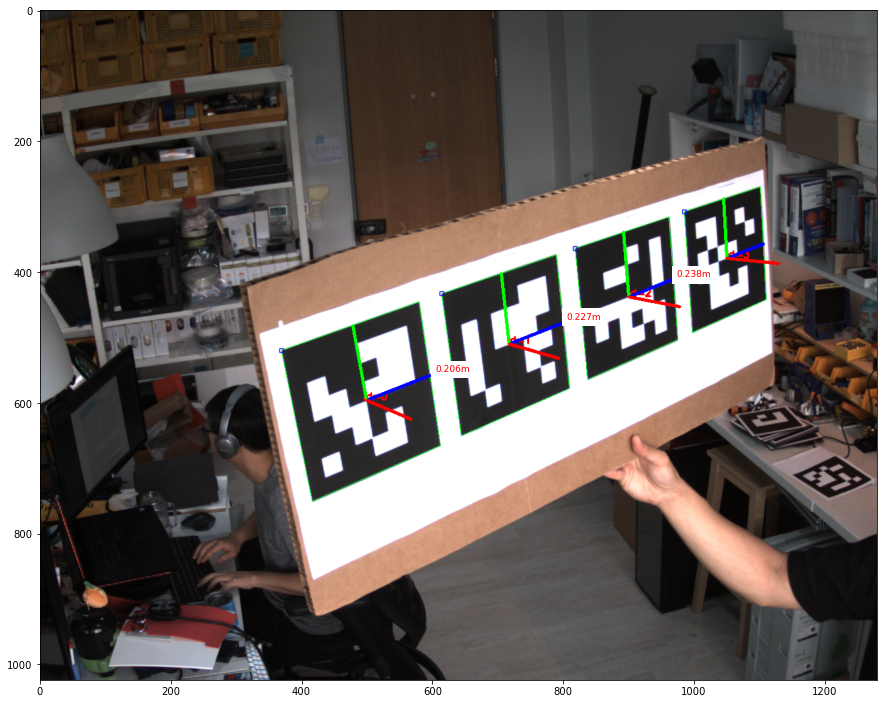

<Figure size 432x288 with 0 Axes>

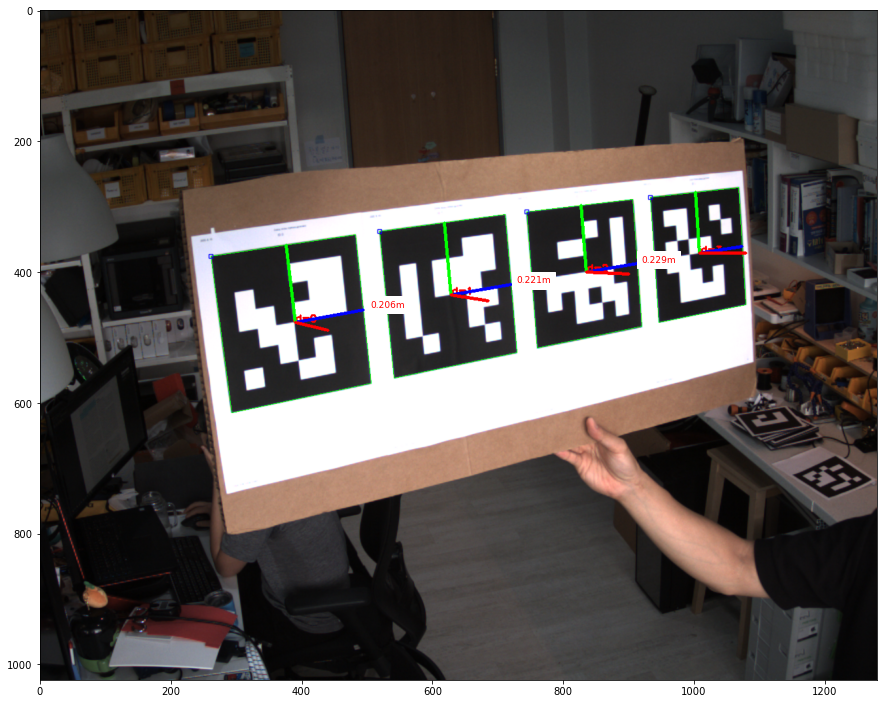

<Figure size 432x288 with 0 Axes>

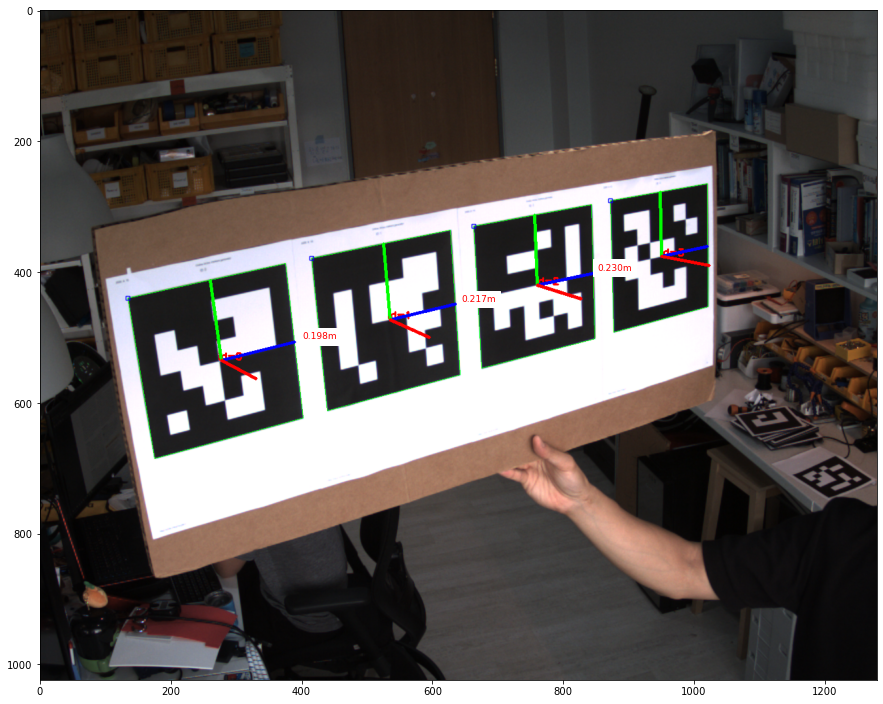

<Figure size 432x288 with 0 Axes>

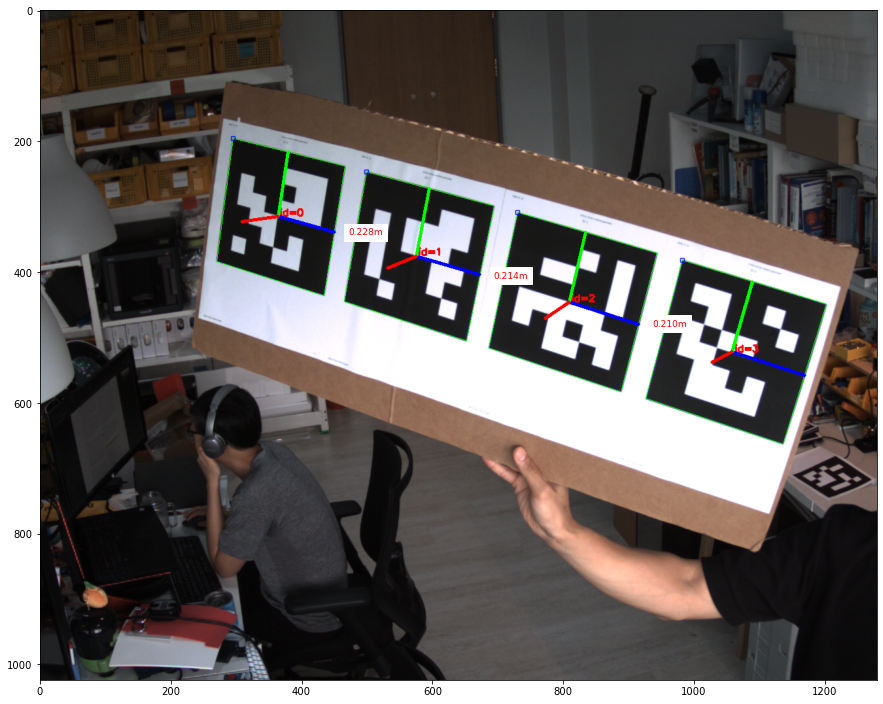

<Figure size 432x288 with 0 Axes>

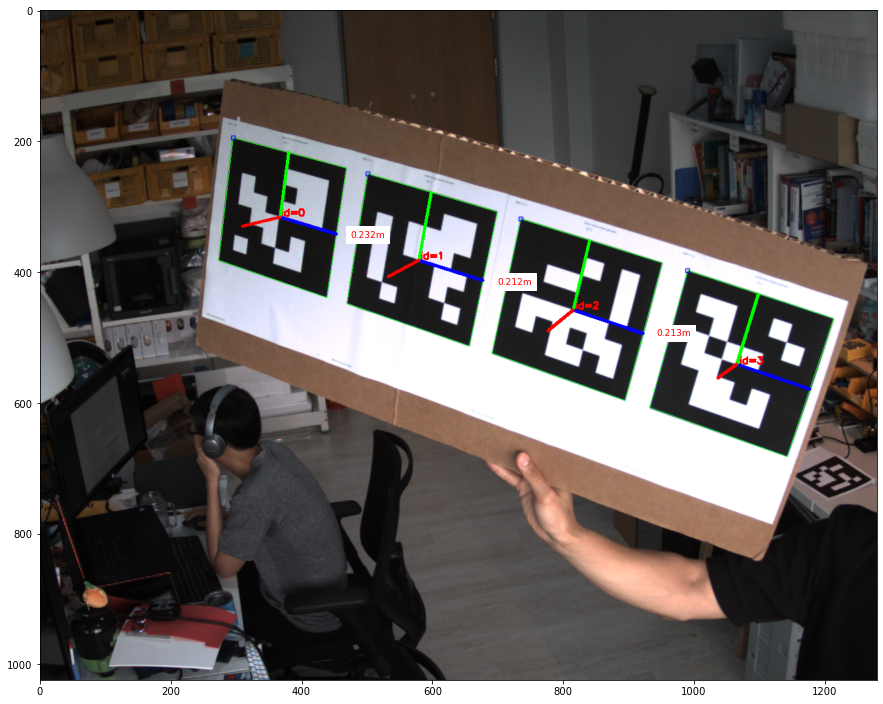

<Figure size 432x288 with 0 Axes>

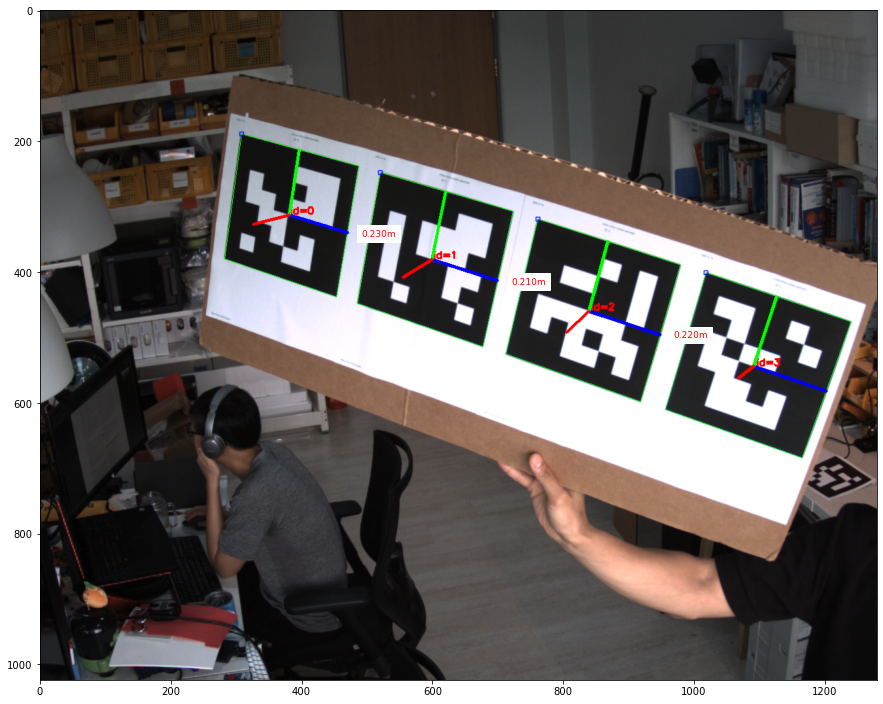

<Figure size 432x288 with 0 Axes>

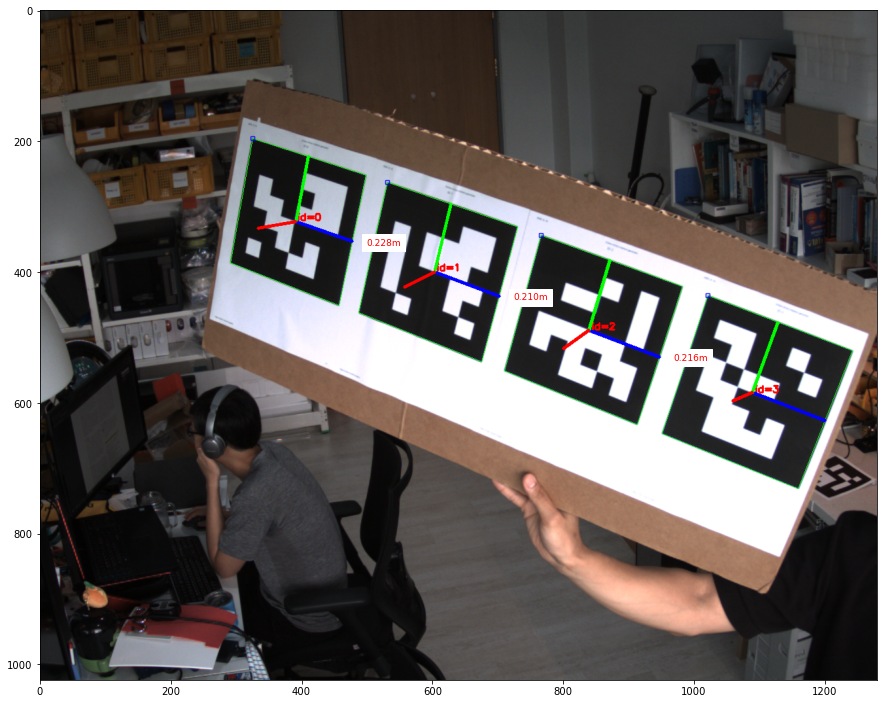

<Figure size 432x288 with 0 Axes>

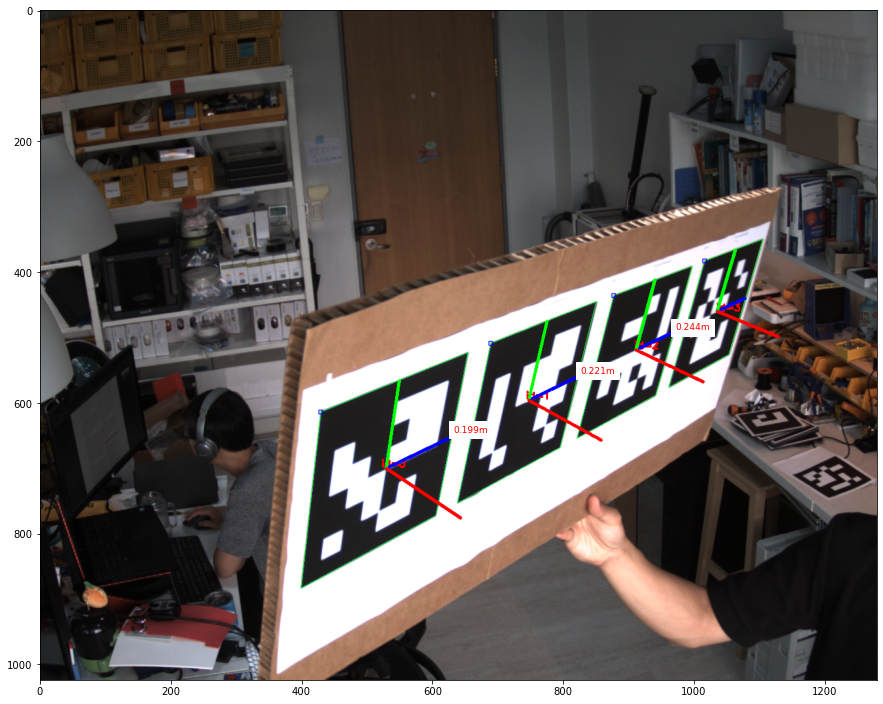

<Figure size 432x288 with 0 Axes>

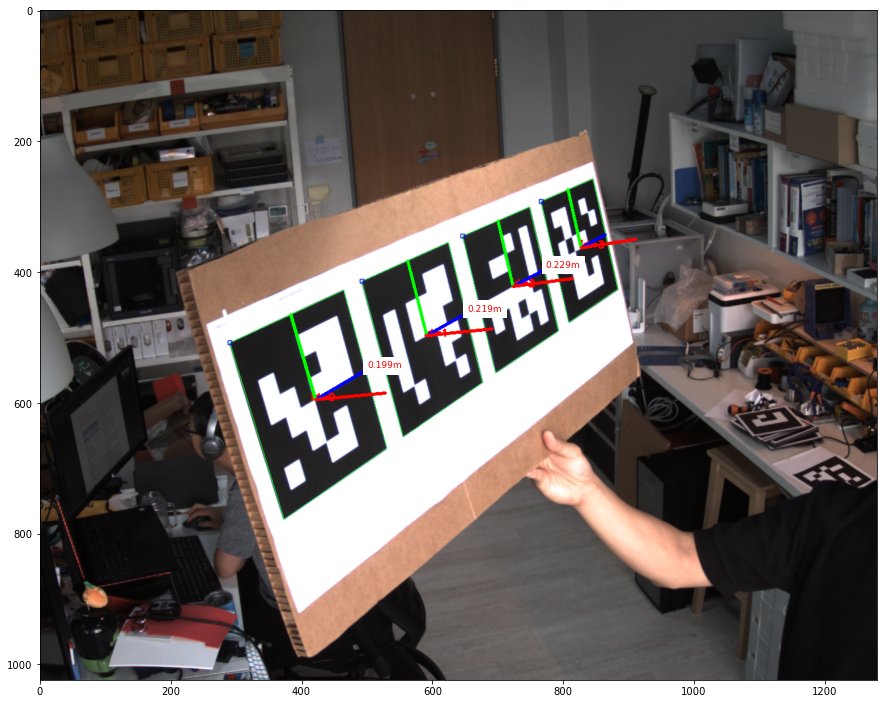

<Figure size 432x288 with 0 Axes>

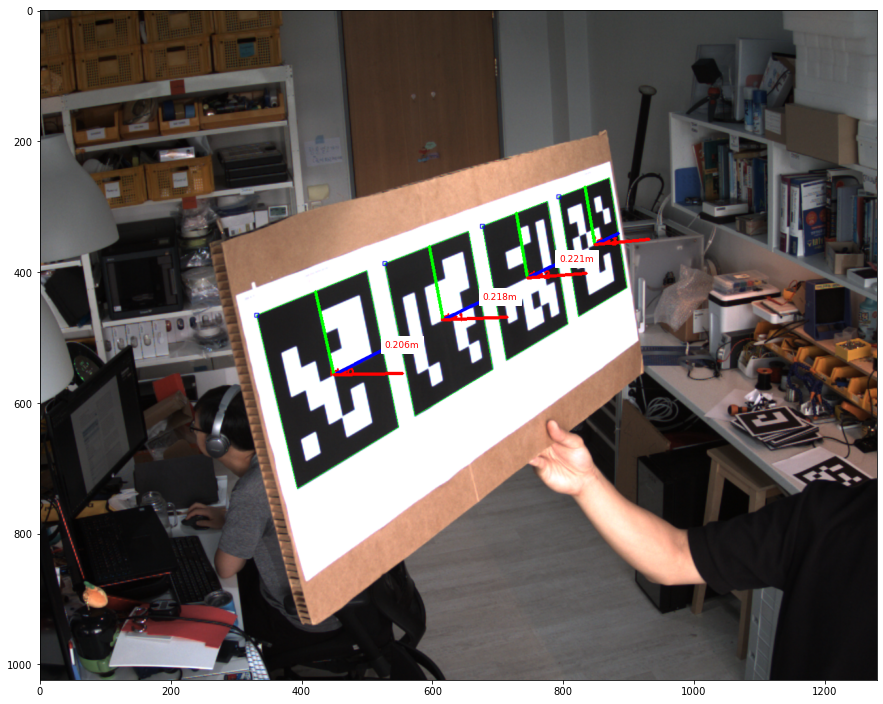

<Figure size 432x288 with 0 Axes>

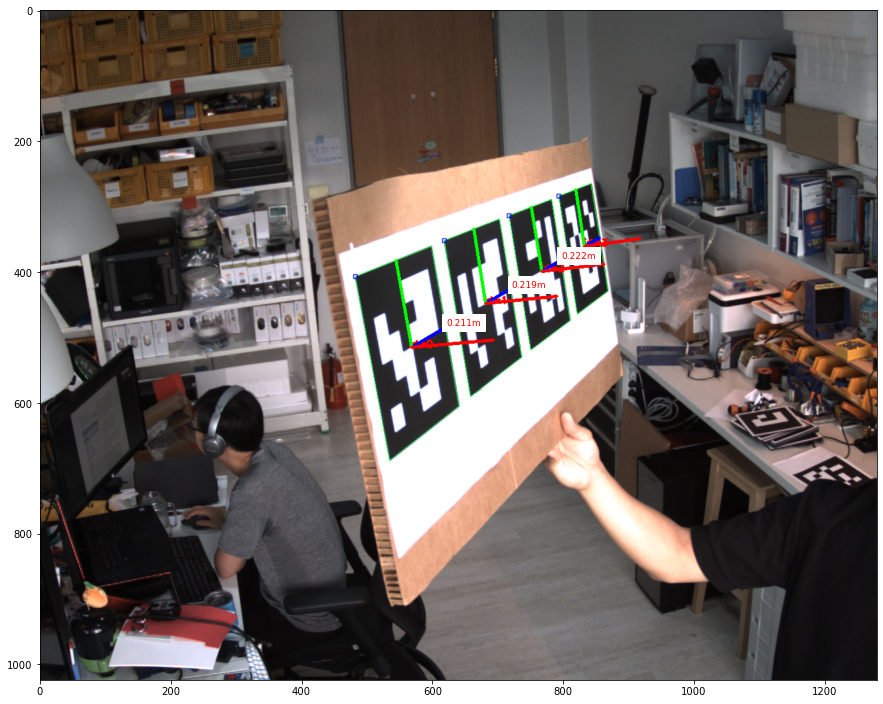

<Figure size 432x288 with 0 Axes>

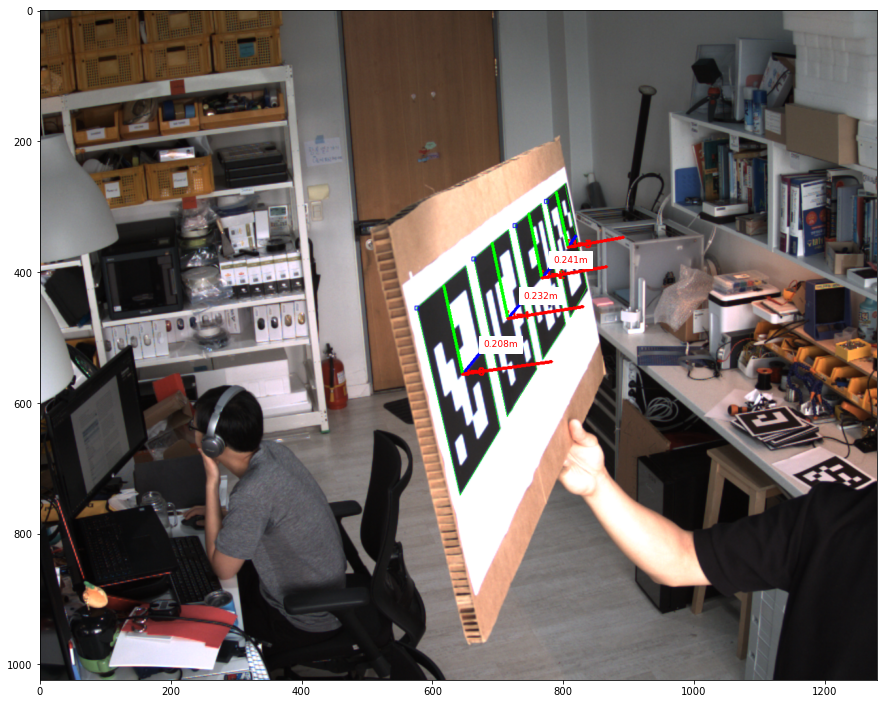

<Figure size 432x288 with 0 Axes>

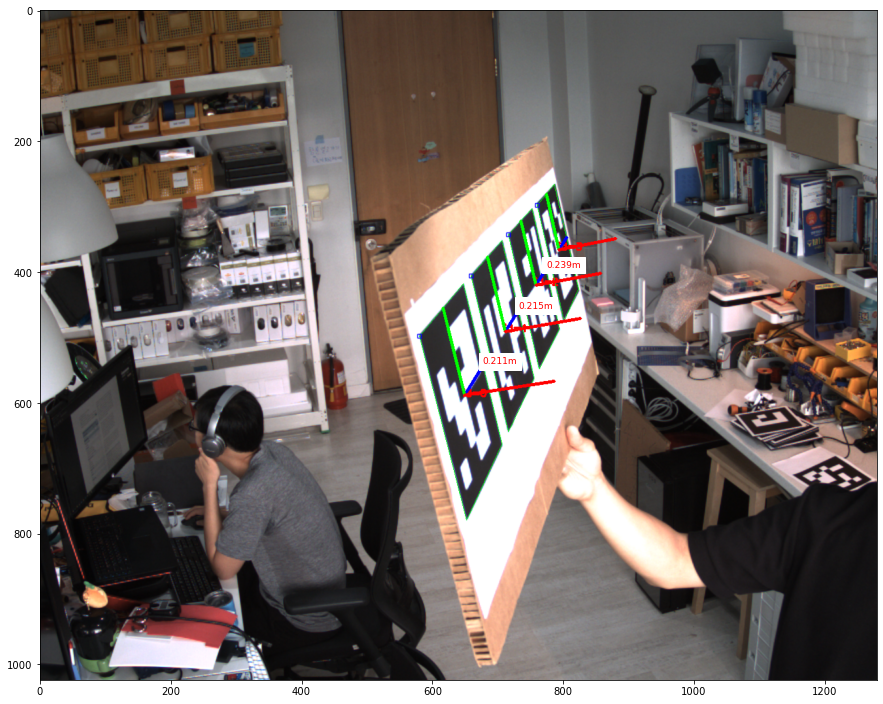

In [75]:
 for image_data in imagefiles:
    image_data = image_data

    aruco_dict = aruco.Dictionary_get(aruco.DICT_6X6_250)
    length_of_axis = 0.09
    markerLength = 0.18
    frame  = cv2.imread(image_data,cv2.IMREAD_UNCHANGED)
    frame = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    parameters =  aruco.DetectorParameters_create()
    corners, ids, rejectedImgPoints = aruco.detectMarkers(gray, aruco_dict, parameters=parameters)

    frame_markers = aruco.drawDetectedMarkers(frame.copy(), corners, ids)

    rvecs,tvecs, objPts = aruco.estimatePoseSingleMarkers(corners, markerLength , mtx, dist)
    imaxis = aruco.drawDetectedMarkers(frame.copy(), corners, ids)
    print(rvecs)
    
    if rvecs is not None and len(rvecs)==4:
        for i in range(len(rvecs)):
            imaxis = aruco.drawAxis(imaxis, mtx, dist, rvecs[i], tvecs[i], length_of_axis)



        # Marker data to dictionary
        marker_dict = {}

        for idx,marker_index in enumerate(ids):
            marker_index = marker_index[0]
            _vecs = {}
            _vecs["rvec"] = rvecs[idx][0]
            _vecs["tvec"] = tvecs[idx][0]
            _vecs["corner"] = corners[idx][0]
            marker_dict[marker_index] = _vecs
        print("tvecs and rvecs for each marker\n")
        # pp.pprint(marker_dict)

        plt.figure()
        plt.figure(figsize=(15,15))

        for idx0,idx1 in [[0,1],[1,2],[2,3]]:
            cen_x, cen_y = np.average([getCenterOnImageFromDic(idx0),getCenterOnImageFromDic(idx1)],axis = 0)
            distance = getDistanceFromDic(idx0,idx1)
            text = plt.text(int(cen_x), int(cen_y), "{:.3f}m".format(distance), fontsize=9,color = "red")
            text.set_bbox(dict(facecolor='white', alpha=1, edgecolor='white'))
        
        plt.imshow(imaxis)
        dir, file = os.path.split(image_data)
        new_dir  = os.path.join(dir,"processed")
       
        plt.savefig( os.path.join(new_dir,file), dpi=300)
        # plt.show()




In [ ]:
dir, file = os.path.split(imagefiles[0])
new_dir  = os.path.join(dir,"processed")
os.path.join(new_dir,file)
